# Using Layout Analysis

This example uses Textractor to predict layout components in a document page and how to visualize them. 

## Installation

To begin, install the `amazon-textract-textractor` package using pip.

`pip install amazon-textract-textractor`

There are various sets of dependencies available to tailor your installation to your use case. The base package will have sensible default, but you may want to install the PDF extra dependencies if your workflow uses PDFs with `pip install amazon-textract-textractor[pdfium]`. You can read more on extra dependencies [in the documentation](https://aws-samples.github.io/amazon-textract-textractor/installation.html)

## Calling Textract

In [1]:
import os
from PIL import Image
from textractor import Textractor
from textractor.visualizers.entitylist import EntityList
from textractor.data.constants import TextractFeatures

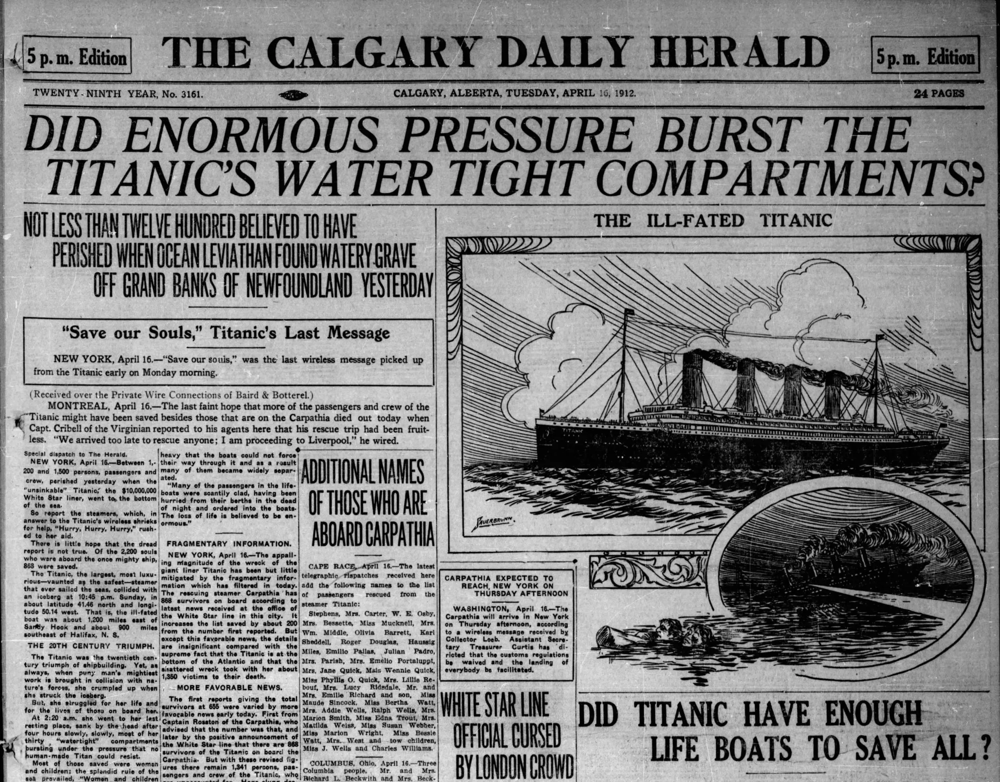

In [2]:
image = Image.open("../../../tests/fixtures/titanic.webp").convert("RGB")
image

In [3]:
extractor = Textractor(region_name="us-west-2")

document = extractor.analyze_document(
    file_source=image,
    features=[TextractFeatures.LAYOUT],
    save_image=True
)

There are two ways to access the resulting layout predictions. The first is `page.layouts` which returns all the layout elements in the page. `layouts` returns an `EntityList` object that you can use to call `visualize()`.

[<textractor.entities.layout.Layout object at 0x7f2b6c977b10>, <textractor.entities.layout.Layout object at 0x7f2b6c977cd0>, <textractor.entities.layout.Layout object at 0x7f2b6c977e10>, <textractor.entities.layout.Layout object at 0x7f2b6c977f50>, <textractor.entities.layout.Layout object at 0x7f2b6c97c0d0>, <textractor.entities.layout.Layout object at 0x7f2b6c97c250>, <textractor.entities.layout.Layout object at 0x7f2b6c97c390>, <textractor.entities.layout.Layout object at 0x7f2b6c97c4d0>, <textractor.entities.layout.Layout object at 0x7f2b6c97c610>, <textractor.entities.layout.Layout object at 0x7f2b6c97c710>, <textractor.entities.layout.Layout object at 0x7f2b6c97c850>, <textractor.entities.layout.Layout object at 0x7f2b6c97c990>, <textractor.entities.layout.Layout object at 0x7f2b6c97cad0>, <textractor.entities.layout.Layout object at 0x7f2b6c97cc10>, <textractor.entities.layout.Layout object at 0x7f2b6c97cd90>, <textractor.entities.layout.Layout object at 0x7f2b6c97ced0>, <textra

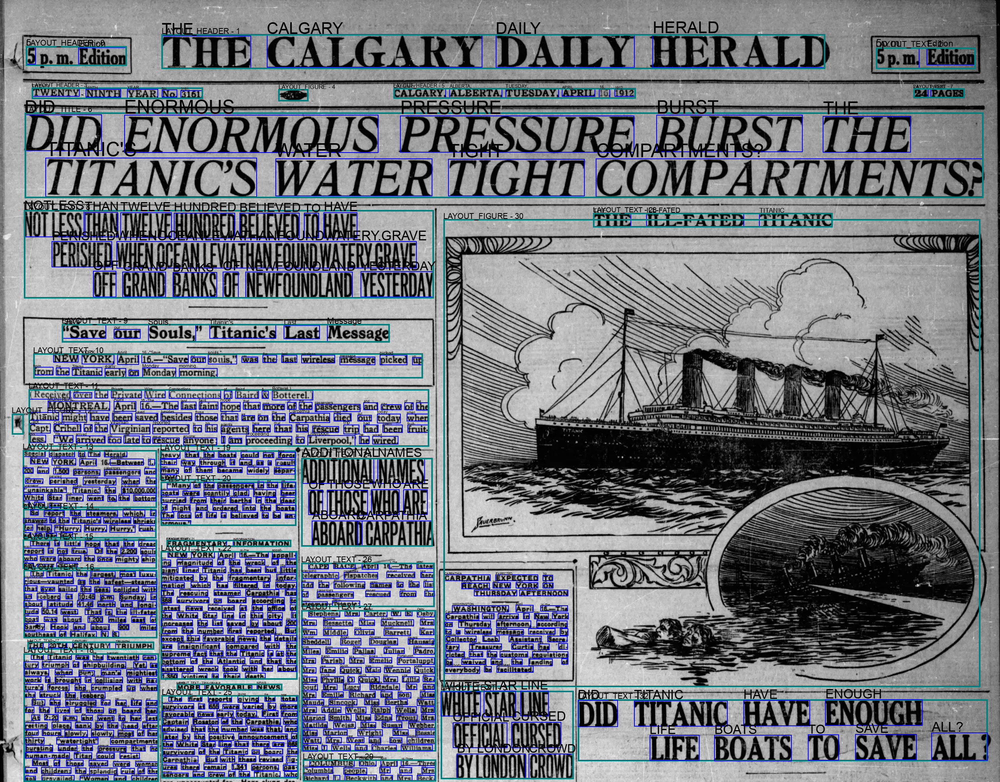

In [4]:
print(document.pages[0].layouts)
document.pages[0].layouts.visualize().convert("RGB")

This is useful, but when processing documents at scale, you might want to get only a subset of the layouts that match your desired use case. To do so, you can use the `page_layout` page property and its own subproperty `titles`, `headers`, `footers`, `tables`, `key_values`, `page_numbers`, `lists` and  `figures`. 

In [5]:
document.pages[0].page_layout.titles[0].text

"DID ENORMOUS PRESSURE BURST THE TITANIC'S WATER TIGHT COMPARTMENTS?"

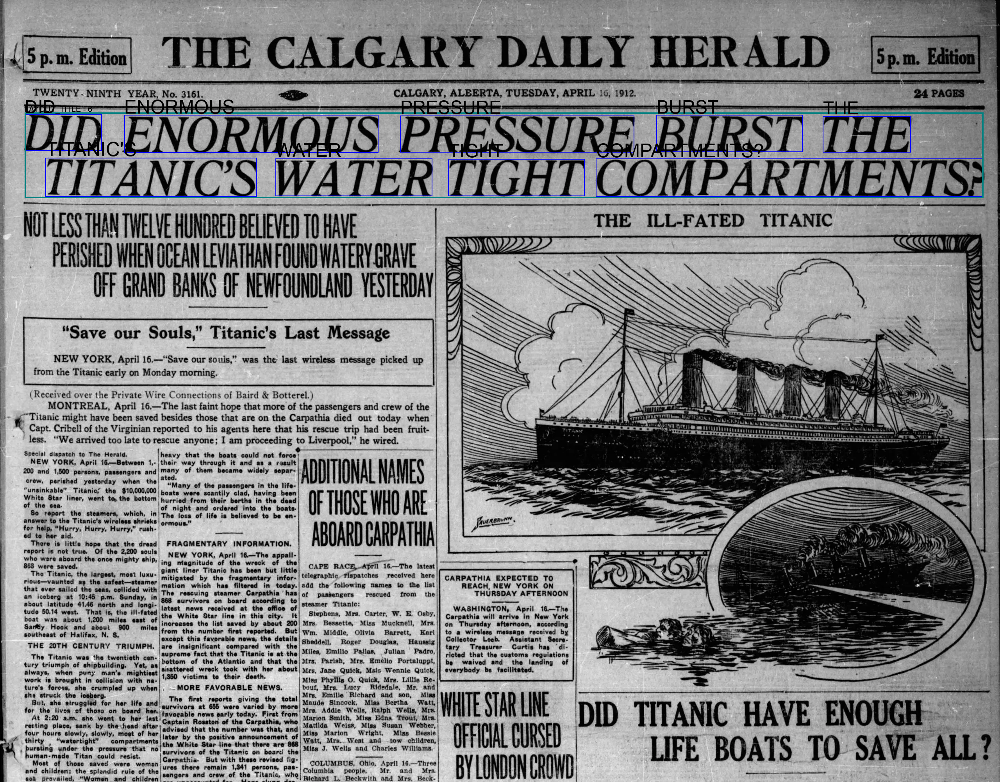

In [6]:
document.pages[0].page_layout.titles[0].visualize().convert("RGB")

The same can be done for figures, allowing you to extract them from the document.

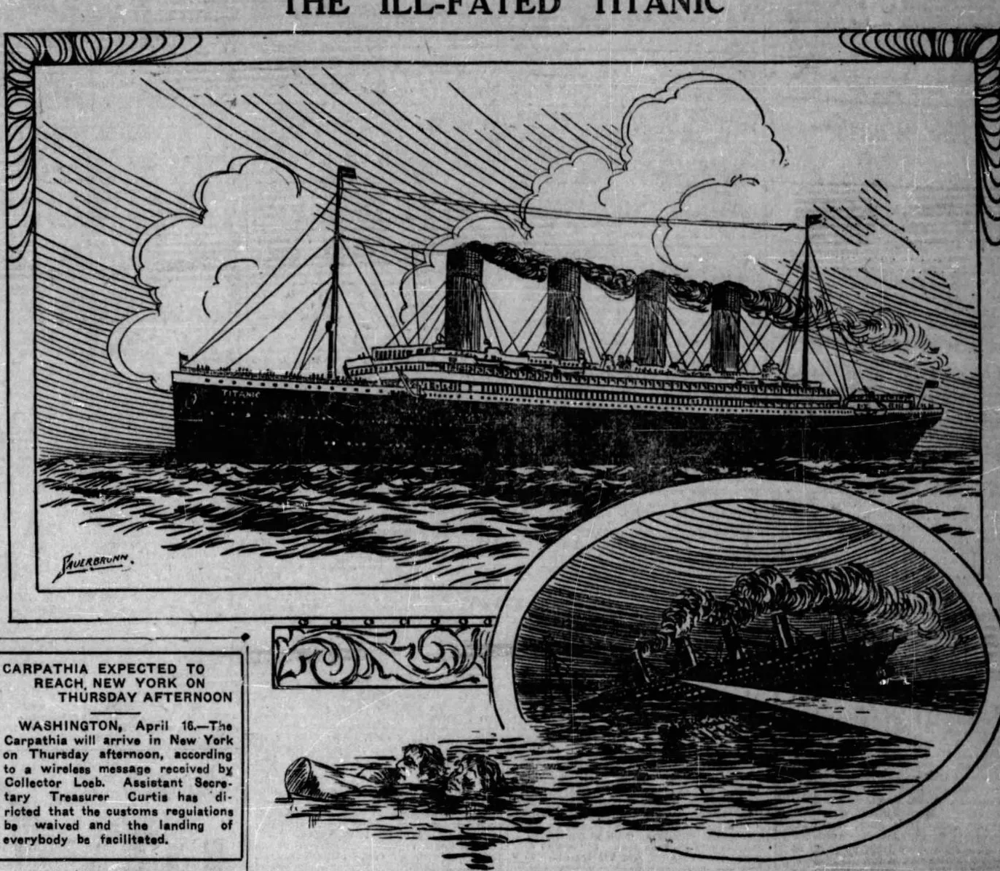

In [7]:
bbox = document.pages[0].page_layout.figures[2].bbox
width, height = document.pages[0].image.size

document.pages[0].image.crop((
    bbox.x * width,
    bbox.y * height,
    (bbox.x + bbox.width) * width,
    (bbox.y + bbox.height) * height
))

## Conclusion

The new Amazon Textract Layout API allows you to extract structured information from documents with complex layouts. 